In [3]:
from sae.hooked_prisma.main import setup
import os
import sys
import torch
import torch.nn.functional as F
import json
import plotly.express as px
from transformer_lens import utils
from datasets import load_dataset
from typing import Dict
from pathlib import Path

from functools import partial
#temp
from sae.hooked_prisma.vision_config import VisionModelRunner

if torch.backends.mps.is_available():
    device = "mps"
else:
    device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)
torch.set_grad_enabled(False)




c:\ProgramData\Anaconda3\envs\vit-prisma\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


cuda


In [4]:
#paths
checkpoint_path= "F:/ViT-Prisma_fork/data/vision_sae_checkpoints"
imagenet_path = "F:/prisma_data/imagenet-object-localization-challenge"
pretrained_path="F:/ViT-Prisma_fork/data/vision_sae_checkpoints/organized/layer_9.pt"
#TODO these are saved in config probably, should load from there (in fact I think it already does). 
# pretrained_layers = [9]
# pretrained_expansion_factor = 32
# pretrained_model_name = "vit_base_patch16_224"
# pretrained_context_size = 197
pretrained_layers = [9]
pretrained_expansion_factor = 32
pretrained_model_name = "vit_base_patch32_224"
pretrained_context_size = 50 


In [8]:
cfg ,model, activations_loader, sae_group = setup(checkpoint_path=checkpoint_path, 
                                                  imagenet_path=imagenet_path ,
                                                    pretrained_path=pretrained_path, layers= pretrained_layers, expansion_factor=pretrained_expansion_factor,
                                                    model_name=pretrained_model_name, context_size=pretrained_context_size)



Run name: 24576-L1-8e-05-LR-0.0004-Tokens-2.000e+06
n_tokens_per_buffer (millions): 0.2048
Lower bound: n_contexts_per_buffer (millions): 0.004096
Total training steps: 488
Total wandb updates: 4
n_tokens_per_feature_sampling_window (millions): 204.8
n_tokens_per_dead_feature_window (millions): 1024.0
Using Ghost Grads.
We will reset the sparsity calculation 0 times.
Number tokens in sparsity calculation window: 4.10e+06
{'n_layers': 12, 'd_model': 768, 'd_head': 64, 'model_name': 'timm/vit_base_patch32_224.augreg_in21k_ft_in1k', 'n_heads': 12, 'd_mlp': 3072, 'activation_name': 'gelu', 'eps': 1e-06, 'original_architecture': 'vit_base_patch32_224', 'initializer_range': 0.02, 'n_channels': 3, 'patch_size': 32, 'image_size': 224, 'n_classes': 1000, 'n_params': 88224232, 'return_type': 'class_logits'}
LayerNorm folded.
Centered weights writing to residual stream
Loaded pretrained model vit_base_patch32_224 into HookedTransformer


In [9]:
for i, sae in enumerate(sae_group):
    hyp = sae.cfg
    print(
        f"{i}: Layer {hyp.hook_point_layer}, p_norm {hyp.lp_norm}, alpha {hyp.l1_coefficient}"
    )

0: Layer 9, p_norm 1, alpha 8e-05


In [10]:
layer_num = 9

sparse_autoencoder = sae_group.autoencoders[0]

## Test the Autoencoder


### L0 Test

In [11]:
sparse_autoencoder.eval()  # prevents error if we're expecting a dead neuron mask for who grads
with torch.no_grad():
    batch_tokens, labels = activations_loader.get_val_batch_tokens()
    _, cache = model.run_with_cache(batch_tokens)
    sae_out, feature_acts, loss, mse_loss, l1_loss, _ = sparse_autoencoder(
        cache[sparse_autoencoder.cfg.hook_point]
    )
    del cache

    # ignore the bos token, get the number of features that activated in each token, averaged accross batch and position
    l0 = (feature_acts[:, 1:] > 0).float().sum(-1).detach()
    print("average l0", l0.mean().item())
    px.histogram(l0.flatten().cpu().numpy()).show()

average l0 216.91900634765625


### Reconstruction test

In [12]:
# next we want to do a reconstruction test.
def reconstr_hook(activation, hook, sae_out):
    return sae_out


def zero_abl_hook(activation, hook):
    return torch.zeros_like(activation)

# orig
class_logits = model(batch_tokens)
loss = F.cross_entropy(class_logits, labels)
print("Orig", loss.item())
# reconstr
class_logts_reconstr = model.run_with_hooks(
        batch_tokens,
        fwd_hooks=[
            (
                utils.get_act_name("resid_pre", layer_num),
                partial(reconstr_hook, sae_out=sae_out),
            )
        ])
loss_reconstr = F.cross_entropy(class_logts_reconstr, labels)
print("reconstr",loss_reconstr.item())

class_logts_zero = model.run_with_hooks(
        batch_tokens,
        fwd_hooks=[(utils.get_act_name("resid_pre", layer_num), zero_abl_hook)],
    )
loss_zero = F.cross_entropy(class_logts_zero, labels)


print("Zero", loss_zero.item())

Orig 0.8395721912384033
reconstr 0.8711541295051575
Zero 7.701769828796387


## Specific Capability Test

Validating model performance on specific tasks when using the reconstructed activation is quite important when studying specific tasks.


In [13]:


ind_to_name = {}

with open( os.path.join(imagenet_path, "LOC_synset_mapping.txt" ), 'r') as file:
    # Iterate over each line in the file
    for line_num, line in enumerate(file):
        line = line.strip()
        if not line:
            continue
        parts = line.split(' ')
        label = parts[1].split(',')[0]
        ind_to_name[line_num] = label









def top_n(logits, n):
    probs = torch.softmax(logits, dim=0)  # Assuming logits are 1D, use dim=-1 for batched operations
    
    # Find the top n probabilities and their indices
    top_probs, top_indices = torch.topk(probs, n)
    
    return top_indices, top_probs
    pass

class_logits = model(batch_tokens)

class_logts_reconstr = model.run_with_hooks(
        batch_tokens,
        fwd_hooks=[
            (
                utils.get_act_name("resid_pre", layer_num),
                partial(reconstr_hook, sae_out=sae_out),
            )
        ])
n=5
for gt, cl, clr in zip(labels, class_logits, class_logts_reconstr):

    top_n_ind, top_n_prob = top_n(cl, n)

    top_n_ind_r, top_n_prob_r = top_n(clr,n)

    print("GROUND TRUTH", ind_to_name[gt.item()])
    print("default")    
    print("-------")

    for i, (ind, p) in enumerate(zip(top_n_ind, top_n_prob)):
        print(f"{i+1} {p.item()*100:05.2f}% {ind_to_name[ind.item()]}")
    print("reconstruct")    
    print("-------")

    for i, (ind, p) in enumerate(zip(top_n_ind_r, top_n_prob_r)):
        print(f"{i+1} {p.item()*100:05.2f}% {ind_to_name[ind.item()]}")

    print("===================")



GROUND TRUTH barbershop
default
-------
1 82.12% barbershop
2 02.37% restaurant
3 01.80% bakery
4 00.71% confectionery
5 00.60% cinema
reconstruct
-------
1 80.10% barbershop
2 05.23% restaurant
3 01.83% bakery
4 00.93% tobacco
5 00.92% cinema
GROUND TRUTH Japanese
default
-------
1 86.12% Japanese
2 05.08% papillon
3 00.99% Pekinese
4 00.34% Pomeranian
5 00.29% Border
reconstruct
-------
1 95.09% Japanese
2 03.11% papillon
3 00.35% Pekinese
4 00.10% Pomeranian
5 00.09% Border
GROUND TRUTH ringneck
default
-------
1 23.42% ringneck
2 11.76% thunder
3 08.31% eft
4 07.31% alligator
5 07.26% common
reconstruct
-------
1 23.69% thunder
2 12.43% common
3 11.69% eft
4 10.92% ringneck
5 07.93% alligator
GROUND TRUTH dam
default
-------
1 97.72% dam
2 00.06% steel
3 00.04% solar
4 00.03% sundial
5 00.03% strainer
reconstruct
-------
1 97.63% dam
2 00.06% sundial
3 00.04% solar
4 00.03% strainer
5 00.02% binoculars
GROUND TRUTH red-backed
default
-------
1 25.96% African
2 04.84% fiddler
3 03.2

# Generating Feature Interfaces (TODO)


In [14]:
vals, inds = torch.topk(feature_acts[0, 0].detach().cpu(), 10) 
px.bar(x=[str(i) for i in inds], y=vals).show()

## Top activations

In [15]:
import pandas as pd
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, Subset, Dataset
import os
import random
import matplotlib.pyplot as plt
import numpy as np
import json
from tqdm import tqdm
from einops import rearrange, repeat
import base64
from sae.hooked_prisma.main import ImageNetValidationDataset
import torchvision


BATCH_INDEX = 'batch_index'
IMAGE_INDEX = 'image_index'
GT_CLASS = 'gt_class'
PRED_CLASS = 'pred_class'
PATCH_INDEX = 'patch_index'
NEURON_INDEX = 'feature_index'
ACTIVATION_VALUE = 'activation'


In [16]:
MAX = 50_000 #TODO I think this isn't needed as of now (so should be full size of dataset)
batch_size = 16

In [31]:



data_transforms = torchvision.transforms.Compose([
    torchvision.transforms.Resize((224, 224)),
    torchvision.transforms.ToTensor(),
])

# assuming the same structure as here: https://www.kaggle.com/c/imagenet-object-localization-challenge/overview/description
imagenet_val_path  =os.path.join(imagenet_path, "ILSVRC/Data/CLS-LOC/val")
imagenet_val_labels = os.path.join(imagenet_path, "LOC_val_solution.csv")
imagenet_label_strings = os.path.join(imagenet_path, "LOC_synset_mapping.txt" )
imagenet_data = ImageNetValidationDataset(imagenet_val_path,imagenet_label_strings, imagenet_val_labels ,data_transforms, return_index=True)


#image_samples = np.random.choice(len(imagenet_data), MAX, replace=False) 

    
#imagenet_data = Subset(imagenet_data, image_samples)

# class ReturnIndexDatasetWrapper(Dataset):

#     def __init__(self, dataset):
#         self.dataset = dataset

#     def __len__(self):
#         return len(self.dataset)
    
#     def __getitem__(self, index):
#         img, label = self.dataset[index]
#         return img, label ,index 
    

# imagenet_data = ReturnIndexDatasetWrapper(imagenet_data)    
data_loader = DataLoader(imagenet_data, batch_size=batch_size, shuffle=False)

In [ ]:




# def process_images(model, total_images, total_labels, image_indices, batch_idx, detach=True, flatten=True):


#     with torch.no_grad():
#         logits_per_image, cache = model.run_with_cache(total_images)
#         sae_out, feature_acts, loss, mse_loss, l1_loss, _ = sparse_autoencoder(
#             cache[sparse_autoencoder.cfg.hook_point]
#         )
#         del cache 

#     probs = logits_per_image.softmax(dim=1)  # we can take the softmax to get the label probabilities
#     class_indices = probs.argmax(dim=1)
#     total_labels = total_labels.to(class_indices.device)

#     #TODO!! deal with extra 
#     batch_activations = feature_acts[:, 1:, :]

#    # TODO Better than looping but maybe could be restructured entirely? (batch_idx, image_idx, class_name, predicted are all constants per batch moreoever they are int. patch_idx, neuron_idx could be infered from shape. Should probably just return activations + 'constants' and figure out the rest when trying to convert to panda?). Intstead I'm trying to mimic the exact format of the old list in a float tensor.... :O


#     b, p, n = batch_activations.shape
#     dt = batch_activations.dtype
#     dev = batch_activations.device

#     patch_index = torch.arange(p, dtype=dt).to(dev)
#     neuron_index = torch.arange(n, dtype=dt).to(dev)

#     patch_index, neuron_index = torch.meshgrid(patch_index, neuron_index, indexing='ij')
#     patch_index = repeat(patch_index, 'h w -> b h w 1', b=b)
#     neuron_index = repeat(neuron_index, 'h w -> b h w 1', b=b)

#     batch_indices = torch.full_like(neuron_index, fill_value=batch_idx)
#     image_indices = torch.tensor(image_indices, dtype=dt).to(dev)

#     image_indices = repeat(image_indices, 'b -> b h w 1', h=p, w=n)
#     gt_class_indices = repeat(total_labels, 'b -> b h w 1', h=p, w=n)
#     pred_class_indices =  repeat(class_indices, 'b -> b h w 1', h=p, w=n)


#     activations_table =torch.concatenate([batch_indices, image_indices,gt_class_indices,pred_class_indices,  patch_index, neuron_index,batch_activations.unsqueeze(-1)], dim=-1)
#     if flatten:
#         activations_table = rearrange(activations_table, 'b h w c -> (b h w) c')
#     if detach:
#         activations_table = activations_table.detach().cpu()
#     return activations_table

# def tensor_activations_to_panda(activations, verbose=True, convert_to_string=False):


    
#     df_activations = pd.DataFrame(activations)



#     # Assign column names
#     df_activations.columns = [ BATCH_INDEX, IMAGE_INDEX, GT_CLASS, PRED_CLASS, PATCH_INDEX, NEURON_INDEX, ACTIVATION_VALUE ]

#     # convert everything but activation to int
#     for int_names in df_activations.columns[:-1]:
#         df_activations[int_names] = df_activations[int_names].astype(int)

#     # convert class indices to string names (a bit slow)
#     if convert_to_string:
#         if verbose:
#             print("converting to string...")
#         #TODO only do this when actually displaying something
#         df_activations[GT_CLASS] = df_activations[GT_CLASS].map(lambda x: ind_to_name[x])
#         df_activations[PRED_CLASS] = df_activations[PRED_CLASS].map(lambda x: ind_to_name[x])
#         if verbose:
#             print("converting done.") 

#     return df_activations

# def process_images_to_panda(model, total_images, total_labels, image_indices, batch_idx, verbose=False, convert_to_string=False):
#     return tensor_activations_to_panda(process_images(model, total_images, total_labels, image_indices, batch_idx), verbose=verbose, convert_to_string=convert_to_string)


In [ ]:



# master_layer_activations = []


# count = 0


# for batch_idx, (total_images, total_labels, total_indices) in tqdm(enumerate(data_loader), total=MAX//batch_size):
#         total_images = total_images.to(device)
#         detailed_activations = process_images(model, total_images, total_labels, total_indices, batch_idx=batch_idx)
#         master_layer_activations.append(detailed_activations)

#         count += batch_size
#         if count >= MAX:
#             break



# activations = torch.cat(master_layer_activations, dim=0)


# df_activations = tensor_activations_to_panda(activations)

# print("sorting..")
# #TODO pytorch sort?
# sorted = df_activations.sort_values(by=[ACTIVATION_VALUE], ascending=False, inplace=False)
# print("sorting done")


# if save_activations:
#     #TODO option to load
#     df_activations.to_parquet(parquet_file_path.format(layer_num), index=False)

In [ ]:
#sorted.head(100)

In [ ]:
# def plot_image_patch_heatmap(images, heatmaps, titles=None, main_title="" ,width=4, alpha=0.4, save=None):
#     if titles is None:
#         titles = [''] * len(images)

#     assert len(images) == len(heatmaps) == len(titles), "Images, heatmaps, and titles must have the same length."
    
#     num_images = len(images)
#     height = int(np.ceil(num_images/width))
#     if height == 1:
#         width = num_images
#     fig, axes = plt.subplots(height, width, figsize=(5*width, 5*height))

#     fig.suptitle(main_title, fontsize=12)

#     if num_images == 1:
#         axes = np.array([[axes]])
   

    
#     for idx, (image, heatmap, title) in enumerate(zip(images, heatmaps, titles)):
#         ax = axes.flatten()[idx]
        
#         image_size = image.shape[-1]
#         pixel_num = heatmap.shape[-1]

#         # Create a heatmap overlay
#         heatmap_expanded = np.zeros((image_size, image_size))
#         patch_size = image_size // pixel_num

#         for i in range(pixel_num):
#             for j in range(pixel_num):
#                 heatmap_expanded[i*patch_size:(i+1)*patch_size, j*patch_size:(j+1)*patch_size] = heatmap[i, j]

#         # Plotting the image with the heatmap overlay
#         ax.imshow(image.permute(1, 2, 0))
#         ax.imshow(heatmap_expanded, cmap='viridis', alpha=0.6)  # Overlaying the heatmap
#         ax.axis('off')  
        
#         min_activation = heatmap.min()
#         max_activation = heatmap.max()



#         ax.set_title(title)

#     # Hide any remaining subplots that don't have data
#     for ax in axes.flatten()[num_images:]:
#         ax.axis('off')
    
#     plt.tight_layout()

#     if save is not None:
#         plt.savefig(save)

#     plt.show()

# def get_activation_array(image_idx, neuron_idx, activations, pixel_num=14):

#     filtered_df = activations[(activations[IMAGE_INDEX] == image_idx) &
#                             (activations[NEURON_INDEX] == neuron_idx)]

#     activation_values = filtered_df[ACTIVATION_VALUE]

#     activation_values_array = activation_values.to_numpy()# TODO!!! bring this back[1:]
#     activation_values_array = activation_values_array.reshape(pixel_num, pixel_num)

#     return activation_values_array

# def plot_activations_heatmap(image_indices, neuron_indices, titles, main_title="", activations=df_activations, dataset=imagenet_data , pixel_num=14, alpha=0.4, save=None):
#     images = []
#     heatmaps = []
#     for image_idx, neuron_idx in zip(image_indices, neuron_indices):

        
#         image = dataset[image_idx][0]


#         images.append(image)
#         heatmaps.append(get_activation_array(image_idx, neuron_idx, activations, pixel_num) )
    
#     plot_image_patch_heatmap(images, heatmaps, titles, main_title=main_title, alpha=alpha, save=save)

In [ ]:
# output_folder = "F:/newTemp/um"
# os.makedirs(output_folder, exist_ok=True)

# interesting_neurons = [46597,30319]
# top_n = 3
# for neuron_idx in  interesting_neurons:

#     df_activations = df_activations
#     df_sorted = sorted
#     #TODO why drop duplicates?
#     unique_top_entries = df_sorted[df_sorted[NEURON_INDEX] == neuron_idx].drop_duplicates(subset=GT_CLASS).head(top_n)

#     images, titles = [], []
#     for i, (image_index, class_name) in enumerate(zip(unique_top_entries[IMAGE_INDEX], unique_top_entries[GT_CLASS])):
#         title = f"Image: {image_index}\nClass: {class_name}"
#         images.append(image_index)
#         titles.append(title)
#     main_title = f"ACTIVATIONS\nNeuron: {neuron_idx}"
#     plot_activations_heatmap(images, [neuron_idx]*len(images), titles, main_title=main_title, activations=df_activations, dataset=imagenet_data, save=os.path.join(output_folder, f"{neuron_idx:04d}_activations.jpg"))

### ARENA stuff

https://arena3-chapter1-transformer-interp.streamlit.app/[1.4]_Superposition_&_SAEs
first getting feature probability

In [32]:
import einops

In [33]:

update_layout_set = {"xaxis_range", "yaxis_range", "hovermode", "xaxis_title", "yaxis_title", "colorbar", "colorscale", "coloraxis", "title_x", "bargap", "bargroupgap", "xaxis_tickformat", "yaxis_tickformat", "title_y", "legend_title_text", "xaxis_showgrid", "xaxis_gridwidth", "xaxis_gridcolor", "yaxis_showgrid", "yaxis_gridwidth", "yaxis_gridcolor", "showlegend", "xaxis_tickmode", "yaxis_tickmode", "margin", "xaxis_visible", "yaxis_visible", "bargap", "bargroupgap", "coloraxis_showscale"}
def to_numpy(tensor):
    """
    Helper function to convert a tensor to a numpy array. Also works on lists, tuples, and numpy arrays.
    """
    if isinstance(tensor, np.ndarray):
        return tensor
    elif isinstance(tensor, (list, tuple)):
        array = np.array(tensor)
        return array
    elif isinstance(tensor, (torch.Tensor, torch.nn.parameter.Parameter)):
        return tensor.detach().cpu().numpy()
    elif isinstance(tensor, (int, float, bool, str)):
        return np.array(tensor)
    else:
        raise ValueError(f"Input to to_numpy has invalid type: {type(tensor)}")

def hist(tensor, renderer=None, **kwargs):
    '''
    '''
    kwargs_post = {k: v for k, v in kwargs.items() if k in update_layout_set}
    kwargs_pre = {k: v for k, v in kwargs.items() if k not in update_layout_set}
    if "bargap" not in kwargs_post:
        kwargs_post["bargap"] = 0.1
    if "margin" in kwargs_post and isinstance(kwargs_post["margin"], int):
        kwargs_post["margin"] = dict.fromkeys(list("tblr"), kwargs_post["margin"])
    px.histogram(x=to_numpy(tensor), **kwargs_pre).update_layout(**kwargs_post).show(renderer)



In [34]:
@torch.no_grad()
def get_feature_probability(
    images,
    model,
    sparse_autoencoder,
):
    '''
    Returns the feature probabilities (i.e. fraction of time the feature is active) for each feature in the
    autoencoder, averaged over all `batch * seq` tokens.
    '''
    batch_size = images.shape[0]
    _, cache = model.run_with_cache(images)
    sae_out, feature_acts, loss, mse_loss, l1_loss, _ = sparse_autoencoder(
        cache[sparse_autoencoder.cfg.hook_point]
    )
    # _, cache = model.run_with_cache(tokens, names_filter = ["blocks.0.mlp.hook_post"])
    # post = cache["blocks.0.mlp.hook_post"]

    post_reshaped = einops.repeat(feature_acts, "batch seq d_mlp -> (batch seq) d_mlp")

    

    return post_reshaped.mean(0)
# Get a batch of feature probabilities & average them (so we don't put strain on the GPU)

total = None

this_max = 5000
for batch_idx, (total_images, total_labels, total_indices) in tqdm(enumerate(data_loader), total=this_max//batch_size):
        total_images = total_images.to(device)
        new = get_feature_probability(total_images, model, sparse_autoencoder)

        if total is None:
             total = new
        else:
             total = total + new 


        if batch_idx*batch_size >= this_max:
            break


313it [00:38,  8.11it/s]                         


In [21]:
feature_probability = total/(this_max//batch_size)

log_freq = (feature_probability + 1e-10).log10()

# Visualise sparsities for each instance
hist(
    log_freq,
    title=f"Log Frequency of Features",
    labels={"x": "log<sub>10</sub>(freq)"},
    histnorm="percent",
    template="ggplot2"
)

Notes: in language this has two peaks. Most of which are uninteresting see: https://docs.google.com/document/u/0/d/187jfZSbhRjjQaazjYlThBsKp3Q0Pw3VdIHVST9H2dvw/mobilebasic
TODO actually understand this so that it's obvious why we have one peak :P 

Next arena looks at reconstruction and substitution loss. Something similar was done above.

In [35]:

def get_reconstruction_loss(
    images,
    model,
    autoencoder,
):
    '''
    Returns the reconstruction loss of each autoencoder instance on the given batch of tokens (i.e.
    the L2 loss between the activations and the autoencoder's reconstructions, averaged over all tokens).
    '''

    logits, cache = model.run_with_cache(images)
    sae_out, feature_acts, loss, mse_loss, l1_loss, mse_loss_ghost_resid = sparse_autoencoder(
        cache[sparse_autoencoder.cfg.hook_point]
    )

    # Print out the avg L2 norm of activations
    print("Avg L2 norm of acts: ", cache[sparse_autoencoder.cfg.hook_point].pow(2).mean().item())

    # Print out the cosine similarity between original neuron activations & reconstructions (averaged over neurons)
    print("Avg cos sim of neuron reconstructions: ", torch.cosine_similarity(einops.rearrange( cache[sparse_autoencoder.cfg.hook_point], "batch seq d_mlp -> (batch seq) d_mlp"),
                                                                              einops.rearrange( sae_out, "batch seq d_mlp -> (batch seq) d_mlp"),
                                                                                dim=0).mean(-1).tolist())
    print("l1", l1_loss.sum().item())
    return mse_loss.item()

this_max = 3
count = 0
print(sparse_autoencoder.cfg.hook_point)
for batch_idx, (total_images, total_labels, total_indices) in enumerate(data_loader):
        total_images = total_images.to(device)
        reconstruction_loss = get_reconstruction_loss(total_images, model, sparse_autoencoder)
        print("mse", reconstruction_loss)



        if batch_idx >= this_max:
            break

blocks.9.hook_resid_pre
Avg L2 norm of acts:  29.51865577697754
Avg cos sim of neuron reconstructions:  0.8986386060714722
l1 0.9555402398109436
mse 0.0204763300716877
Avg L2 norm of acts:  30.223709106445312
Avg cos sim of neuron reconstructions:  0.8994979858398438
l1 0.9404643774032593
mse 0.019698701798915863
Avg L2 norm of acts:  30.400768280029297
Avg cos sim of neuron reconstructions:  0.8970529437065125
l1 0.9806569814682007
mse 0.020421037450432777
Avg L2 norm of acts:  31.58968162536621
Avg cos sim of neuron reconstructions:  0.8993019461631775
l1 0.9581602215766907
mse 0.020198971033096313


Notes:
Language model results for comparsion
Avg L2 norm of acts:  0.11062075197696686
Avg cos sim of neuron reconstructions:  0.8348199129104614
l1 19.51767921447754
mse 0.043452925980091095



In [36]:

@torch.inference_mode()
# count how often a feature is activated
def count_activated(
    images,
    model,
    autoencoder,
    threshold,
):
    '''
    Returns the indices & values for the highest-activating tokens in the given batch of data.
    '''

    logits, cache = model.run_with_cache(images)
    sae_out, feature_acts, loss, mse_loss, l1_loss, mse_loss_ghost_resid = autoencoder(
        cache[autoencoder.cfg.hook_point]
    )
    feature_acts = einops.rearrange(feature_acts, "batch seq d_mlp -> (batch seq) d_mlp")
    feature_probability = feature_acts
    log_freq = (feature_probability + 1e-10).log10()



    activated_neurons = log_freq > threshold 

    # print(activated_neurons.shape, torch.count_nonzero(activated_neurons),(activated_neurons.shape[0]))
    # print(100*torch.count_nonzero(activated_neurons).item()/(activated_neurons.shape[0]))

    hit_count = torch.count_nonzero(activated_neurons, dim=0)

    
    return hit_count




total = None
threshold = -3
this_max = 5000
count = 0
for batch_idx, (total_images, total_labels, total_indices) in tqdm(enumerate(data_loader), total=this_max//batch_size):
        total_images = total_images.to(device)
        new = count_activated(total_images, model, sparse_autoencoder, threshold)

        if total is None:
             total = new
        else:
             total = total + new 



        if batch_idx*batch_size >= this_max:
            break


313it [00:37,  8.38it/s]                         


In [24]:
top_vals, top_inds = total.topk(10)
top_vals = vals.tolist()
top_inds = inds.tolist()
for v,i in zip(top_vals, top_inds):
    print(v,i)




32.63816833496094 8369
31.953493118286133 634
22.901918411254883 4612
14.649801254272461 5184
5.616640567779541 4577
4.691309928894043 4730
4.0710673332214355 4557
2.574458599090576 18027
1.6887420415878296 13524
1.2689439058303833 876


In [41]:

from typing import List
torch.no_grad()
def highest_activating_tokens(
    images,
    model,
    sparse_autoencoder,
    feature_ids: List[int],
    k: int = 10,
):
    '''
    Returns the indices & values for the highest-activating tokens in the given batch of data.
    '''

    # Get the post activations from the clean run
    _, cache = model.run_with_cache(images)

    
    # here
    

    # sae_out, feature_acts, loss, mse_loss, l1_loss, mse_loss_ghost_resid = sparse_autoencoder(
    #     cache[sparse_autoencoder.cfg.hook_point]
    # )
    post_reshaped = einops.rearrange( cache[sparse_autoencoder.cfg.hook_point], "batch seq d_mlp -> (batch seq) d_mlp")
    seq_len = cache[sparse_autoencoder.cfg.hook_point].shape[1]
    # Compute activations (not from a fwd pass, but explicitly, by taking only the feature we want)
    # This code is copied from the first part of the 'forward' method of the AutoEncoder class
    sae_in =  post_reshaped - sparse_autoencoder.b_dec # Remove decoder bias as per Anthropic

    acts = einops.einsum(
            sae_in,
            sparse_autoencoder.W_enc[:, feature_ids],
            "... d_in, d_in n -> ... n",
        )
    to_return = {} 
    #TODO this is a bad way to do it.
    for i, feature_id in enumerate(feature_ids):
        # Get the top k largest activations
        top_acts_values, top_acts_indices = acts[:,i].topk(k)

        # Convert the indices into (batch, seq) indices
        top_acts_batch = top_acts_indices // seq_len
        top_acts_seq = top_acts_indices % seq_len

        to_return[feature_id]  = (torch.stack([top_acts_batch, top_acts_seq], dim=-1), top_acts_values)
    return to_return 
this_max = 10_000

max_indices = {i:None for i in top_inds}
max_values =  {i:None for i in top_inds} 
for batch_idx, (total_images, total_labels, total_indices) in tqdm(enumerate(data_loader), total=this_max//batch_size):
        total_images = total_images.to(device)
        total_indices = total_indices.to(device)
        new_stuff = highest_activating_tokens(total_images, model, sparse_autoencoder, top_inds)
        for feature_id in top_inds:

            new_indices, new_values = new_stuff[feature_id]
            new_indices[:,0] = total_indices[new_indices[:,0]]
            #  new_indices[:,0] = new_indices[:,0] + batch_idx*batch_size
            
            if max_indices[feature_id] is None:
                max_indices[feature_id] = new_indices
                max_values[feature_id] = new_values
            else:
                ABvals = torch.cat((max_values[feature_id], new_values))
                ABinds = torch.cat((max_indices[feature_id], new_indices), dim=0)
                _, inds = torch.topk(ABvals, new_values.shape[0])
                max_values[feature_id] = ABvals[inds]
                max_indices[feature_id] = ABinds[inds]
    

        if batch_idx*batch_size >= this_max:
            break
top_per_feature = {i:(max_values[i].detach().cpu(), max_indices[i].detach().cpu()) for i in top_inds}

  0%|          | 0/625 [00:00<?, ?it/s]

torch.Size([16, 3, 224, 224]) input


RuntimeError: stack expects each tensor to be equal size, but got [16, 49, 768] at entry 0 and [16, 50, 768] at entry 1

looking at 8369
tensor([36.6594, 36.6442, 36.5167, 36.4404, 36.2604, 36.2432, 36.2423, 36.2048,
        36.1863, 36.1611])
10910 tensor(10910)
30175 tensor(30175)
15257 tensor(15257)
48629 tensor(48629)
38874 tensor(38874)
34819 tensor(34819)
34451 tensor(34451)
21160 tensor(21160)
17877 tensor(17877)
31954 tensor(31954)


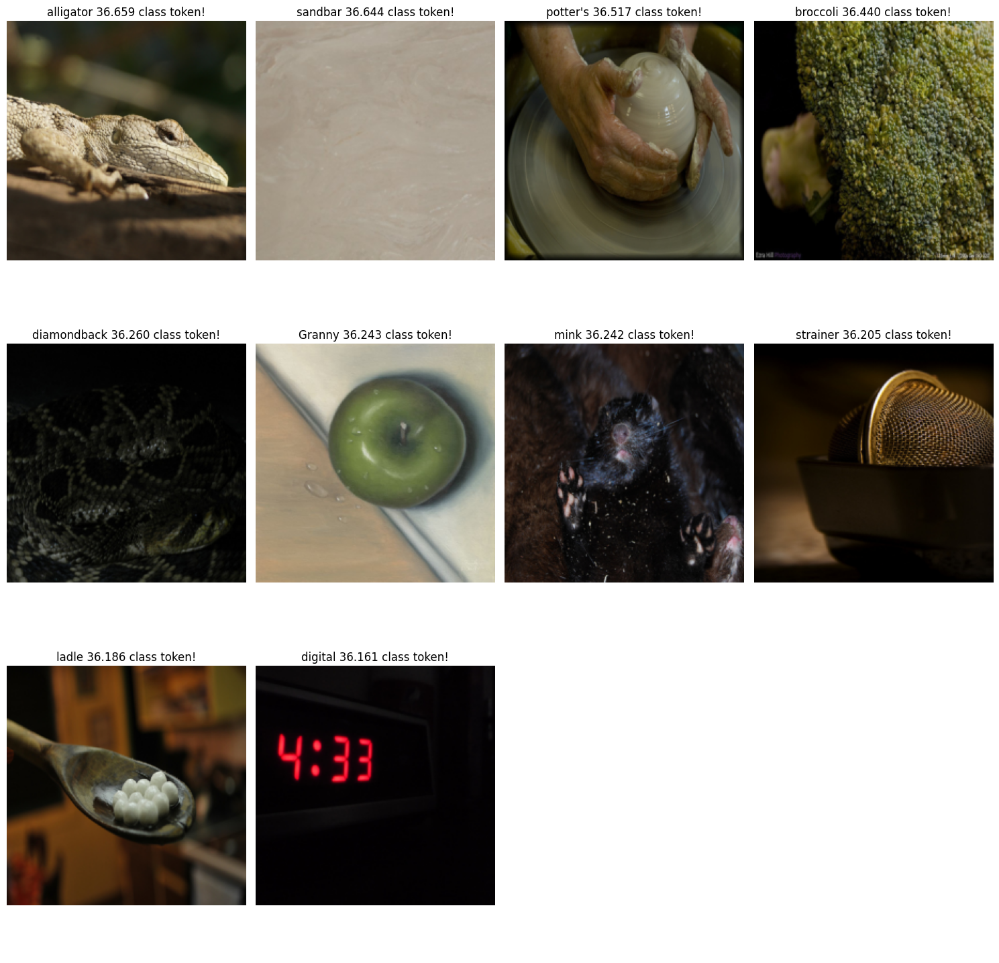

looking at 634
tensor([58.4336, 58.0221, 57.8518, 57.7725, 57.4536, 56.7356, 56.5790, 56.2643,
        55.4953, 55.1642])
5547 tensor(5547)
46048 tensor(46048)
20966 tensor(20966)
3823 tensor(3823)
48506 tensor(48506)
21688 tensor(21688)
28953 tensor(28953)
44478 tensor(44478)
21237 tensor(21237)
33726 tensor(33726)


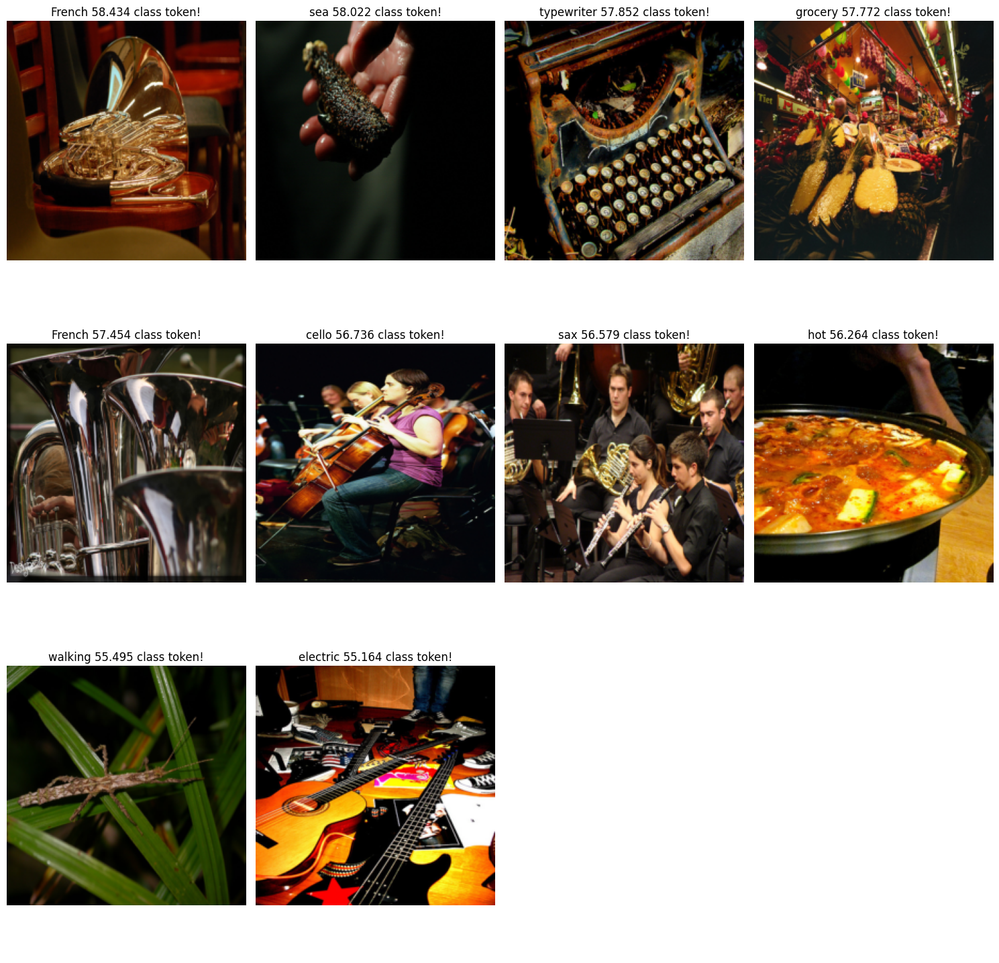

looking at 4612
tensor([37.6016, 37.4963, 37.4933, 37.3837, 36.9773, 36.7520, 36.7148, 36.6742,
        36.4185, 36.3062])
6652 tensor(6652)
27552 tensor(27552)
8724 tensor(8724)
43560 tensor(43560)
18065 tensor(18065)
42284 tensor(42284)
43113 tensor(43113)
46970 tensor(46970)
32552 tensor(32552)
18624 tensor(18624)


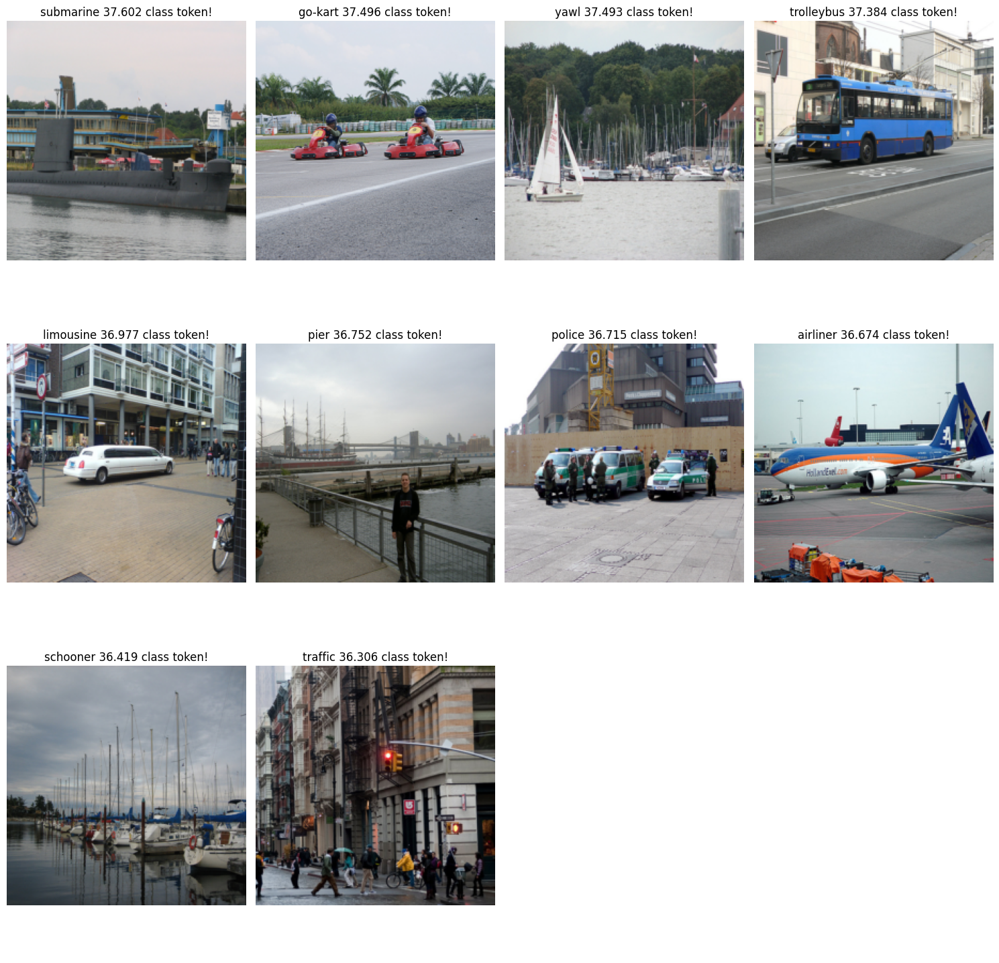

looking at 5184
tensor([40.6494, 37.8000, 36.4890, 35.4767, 35.4083, 35.3865, 35.3754, 35.2577,
        35.2523, 35.1091])
28734 tensor(28734)
34538 tensor(34538)
45167 tensor(45167)
44155 tensor(44155)
44273 tensor(44273)
22820 tensor(22820)
35113 tensor(35113)
17879 tensor(17879)
17301 tensor(17301)
27170 tensor(27170)


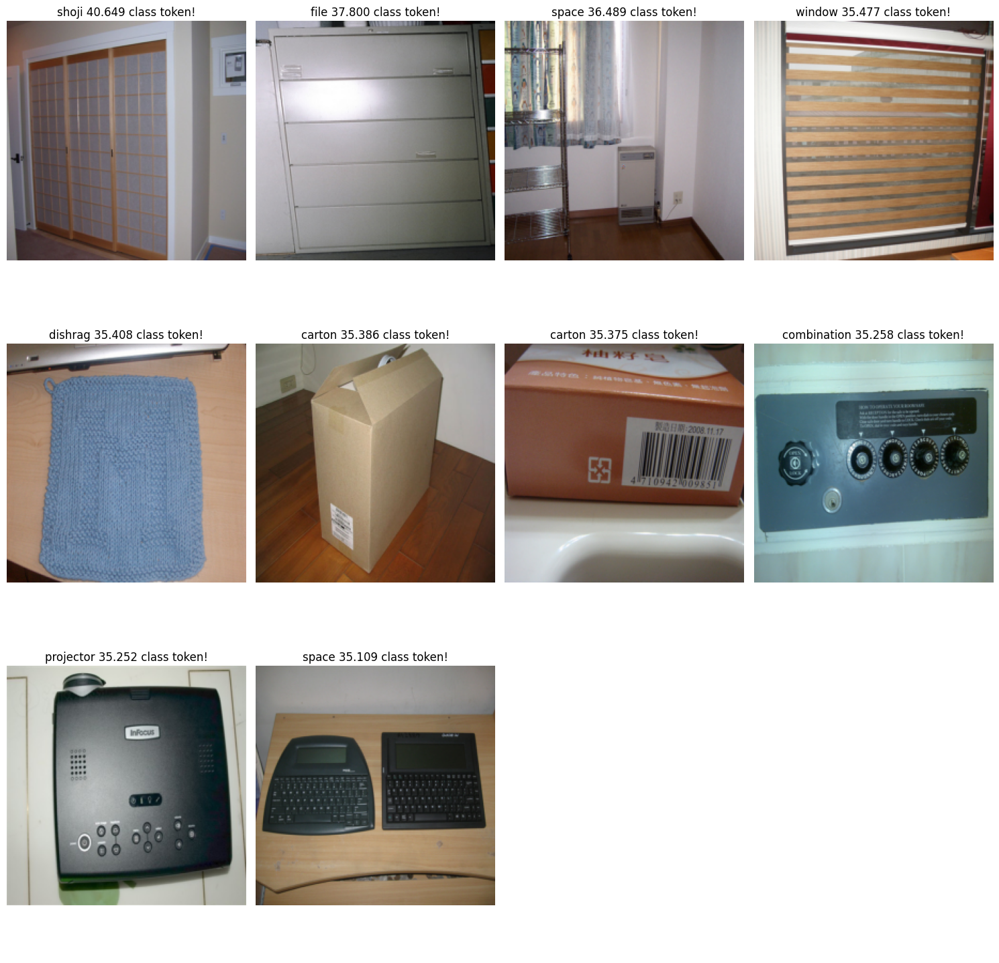

looking at 4577
tensor([43.8270, 39.4264, 37.4349, 37.0652, 35.9329, 34.9687, 34.3339, 34.2849,
        33.2016, 33.0071])
46992 tensor(46992)
16006 tensor(16006)
2860 tensor(2860)
38410 tensor(38410)
25344 tensor(25344)
21415 tensor(21415)
23387 tensor(23387)
4580 tensor(4580)
23000 tensor(23000)
17719 tensor(17719)


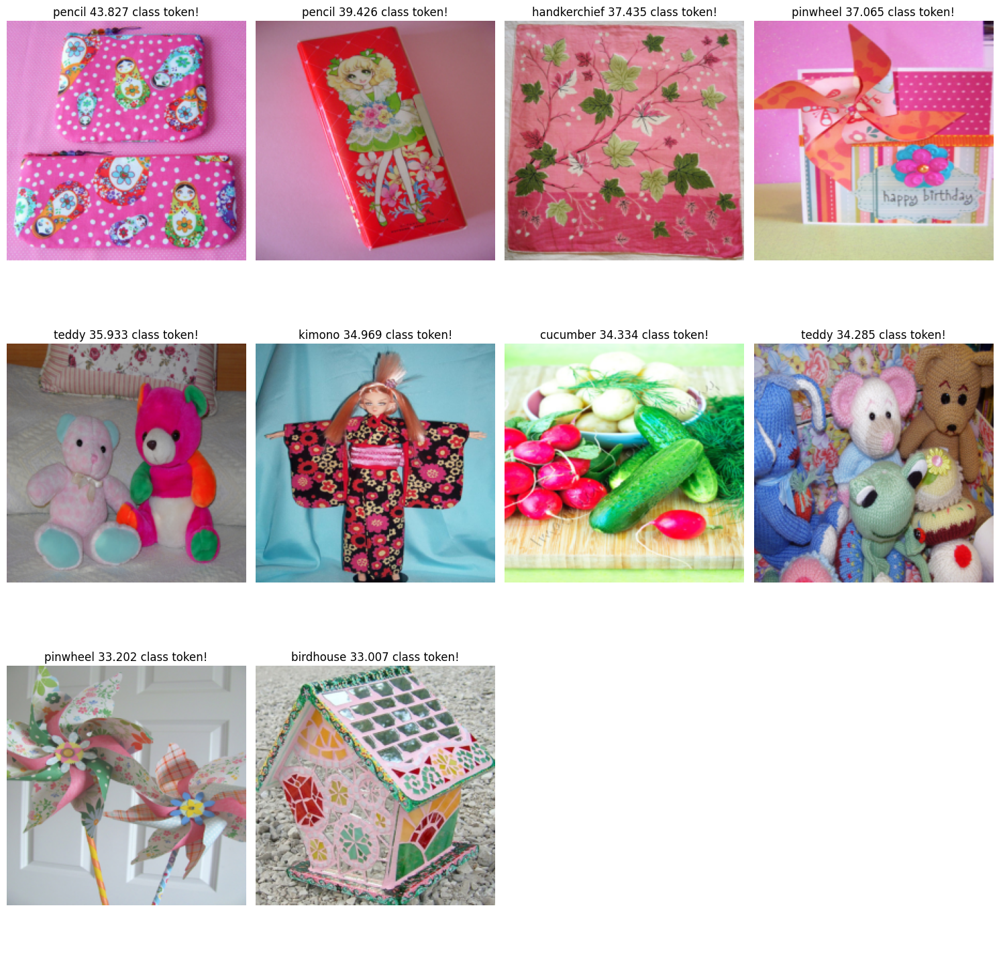

looking at 4730
tensor([45.2577, 43.6598, 43.6026, 43.3507, 41.8192, 41.2036, 40.7695, 40.4966,
        40.3920, 40.3070])
35156 tensor(35156)
4616 tensor(4616)
6023 tensor(6023)
36527 tensor(36527)
16485 tensor(16485)
5126 tensor(5126)
26508 tensor(26508)
4507 tensor(4507)
22087 tensor(22087)
47024 tensor(47024)


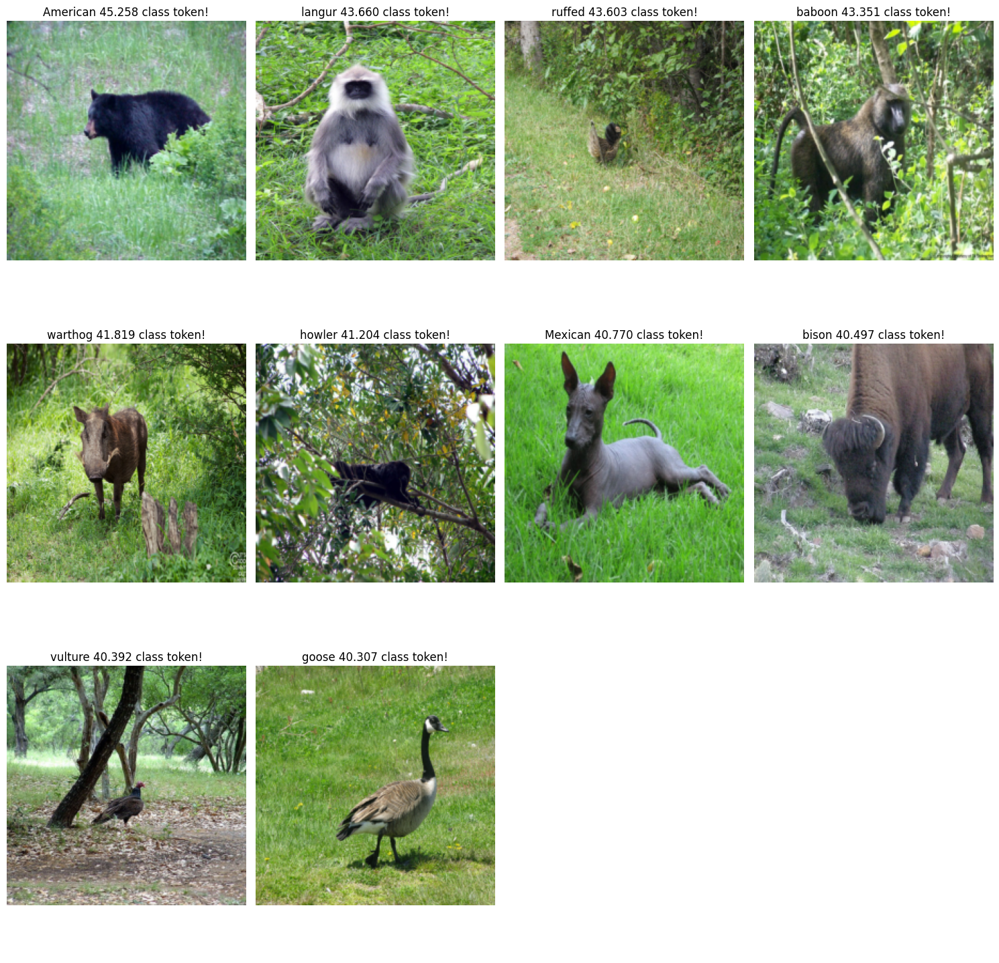

looking at 4557
tensor([32.2303, 31.6480, 31.1579, 31.0908, 31.0719, 30.9651, 30.9412, 30.8697,
        30.5933, 30.5813])
32922 tensor(32922)
37181 tensor(37181)
15196 tensor(15196)
715 tensor(715)
20727 tensor(20727)
25287 tensor(25287)
7633 tensor(7633)
16972 tensor(16972)
26086 tensor(26086)
33230 tensor(33230)


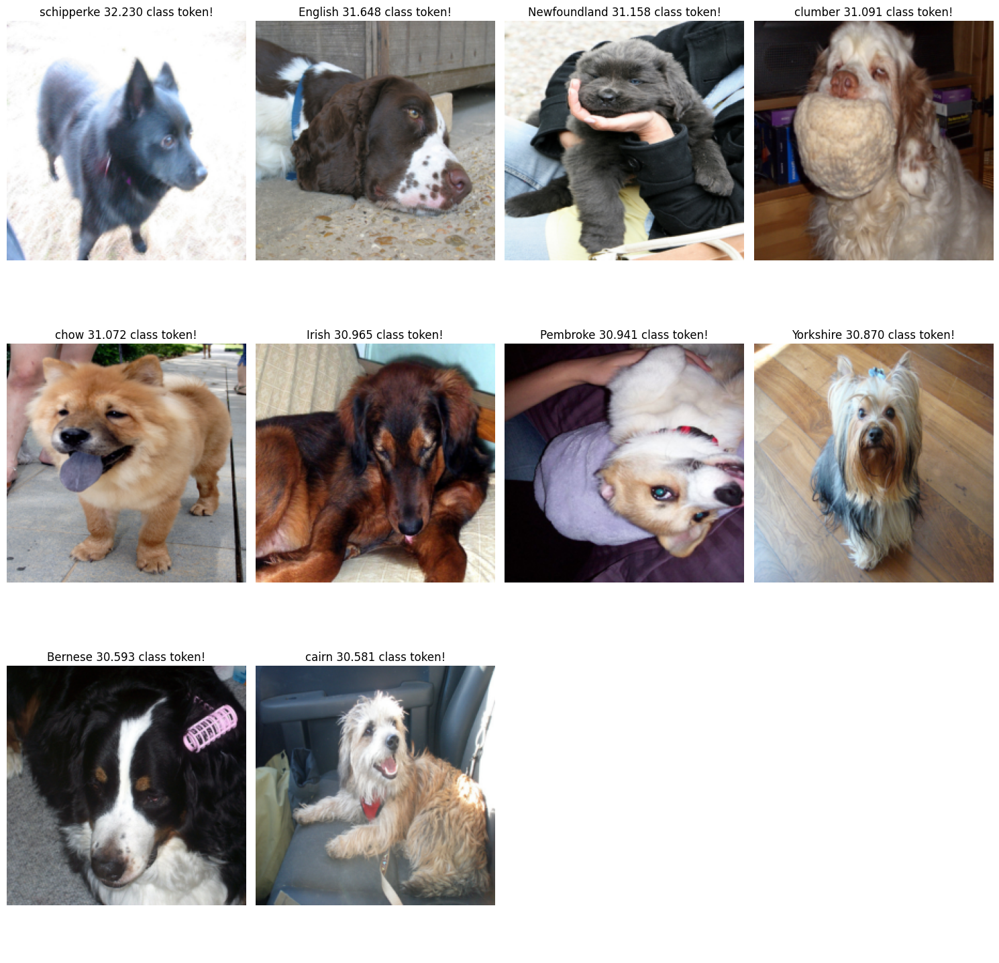

looking at 18027
tensor([17.6514, 17.5418, 17.4876, 17.4387, 17.2907, 17.2519, 16.8929, 16.8630,
        16.8111, 16.6604])
38397 tensor(38397)
27185 tensor(27185)
45612 tensor(45612)
28651 tensor(28651)
32756 tensor(32756)
6487 tensor(6487)
31989 tensor(31989)
34642 tensor(34642)
43735 tensor(43735)
24709 tensor(24709)


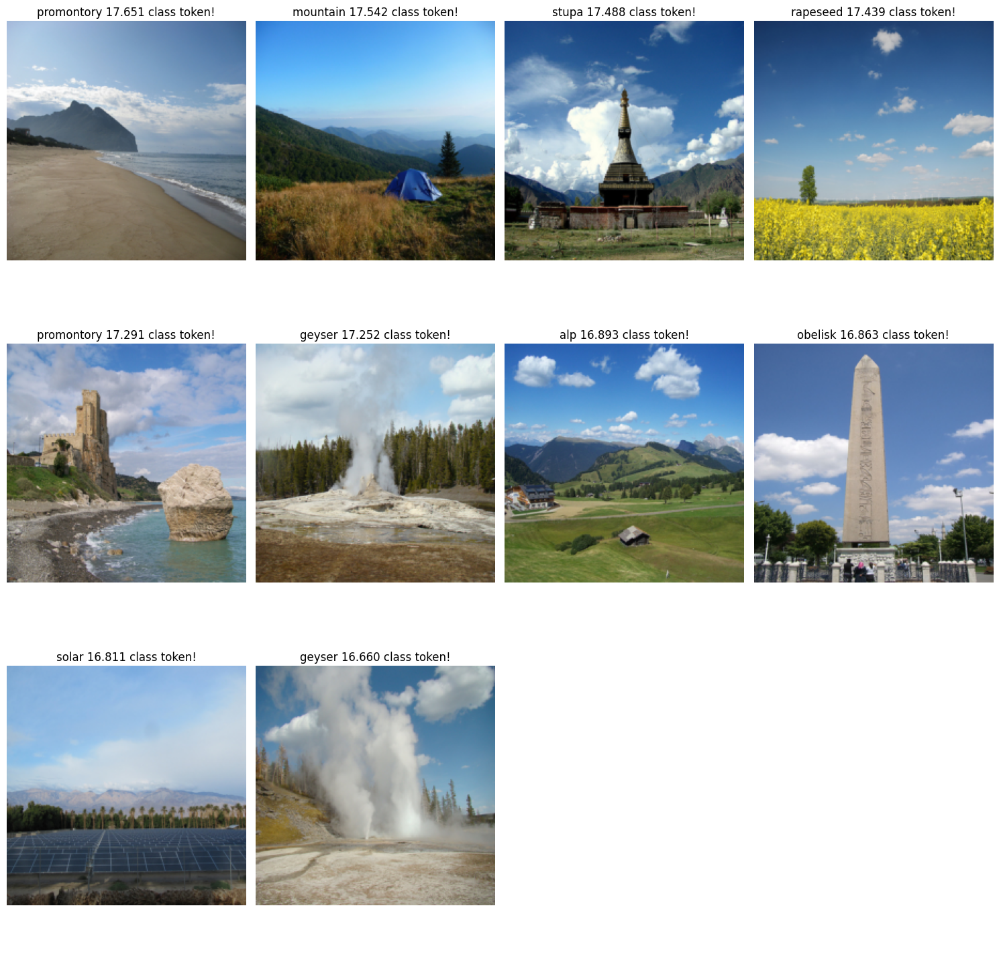

looking at 13524
tensor([43.1274, 41.7622, 41.5184, 41.3892, 40.9480, 40.8712, 39.9404, 39.2519,
        39.0886, 39.0521])
33545 tensor(33545)
17946 tensor(17946)
43558 tensor(43558)
13584 tensor(13584)
39405 tensor(39405)
31583 tensor(31583)
29486 tensor(29486)
46818 tensor(46818)
44287 tensor(44287)
11534 tensor(11534)


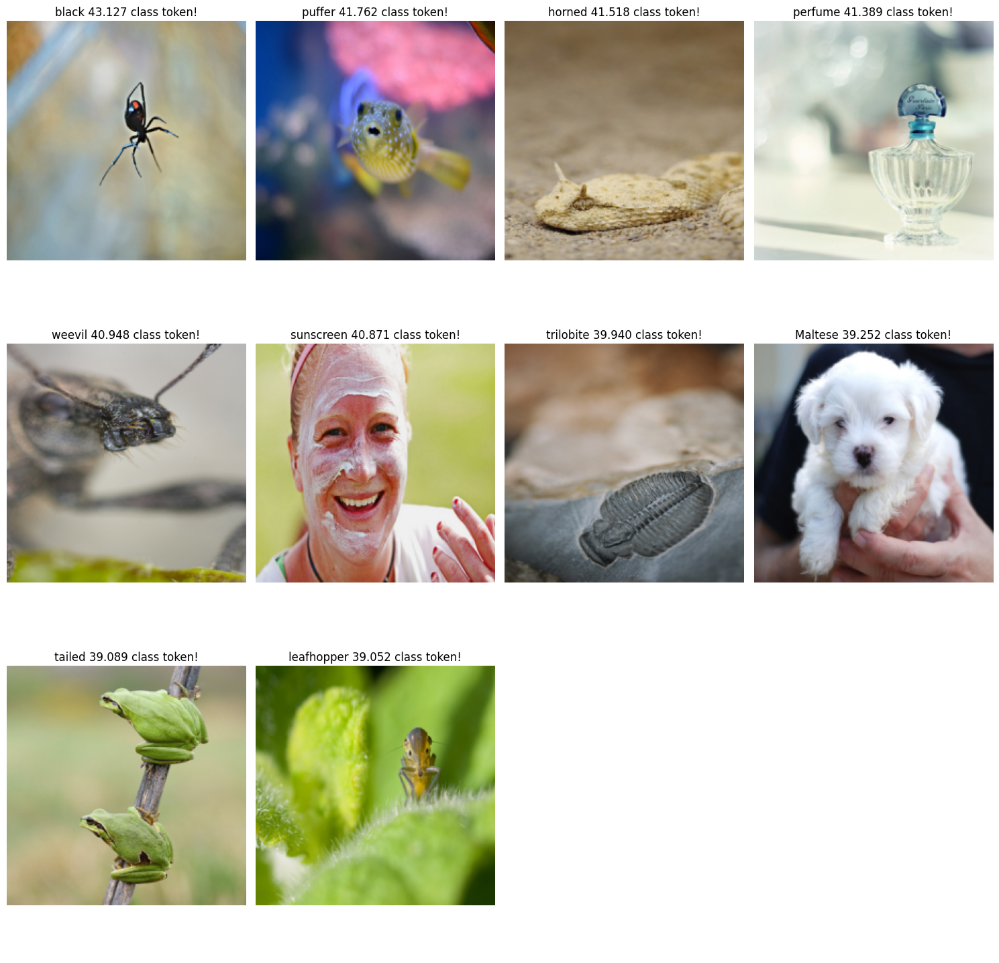

looking at 876
tensor([46.5409, 45.1468, 44.9707, 44.3416, 44.2510, 42.4682, 42.4425, 42.0958,
        41.4484, 40.4465])
18562 tensor(18562)
14726 tensor(14726)
2140 tensor(2140)
33414 tensor(33414)
13313 tensor(13313)
30968 tensor(30968)
25728 tensor(25728)
5974 tensor(5974)
33705 tensor(33705)
24608 tensor(24608)


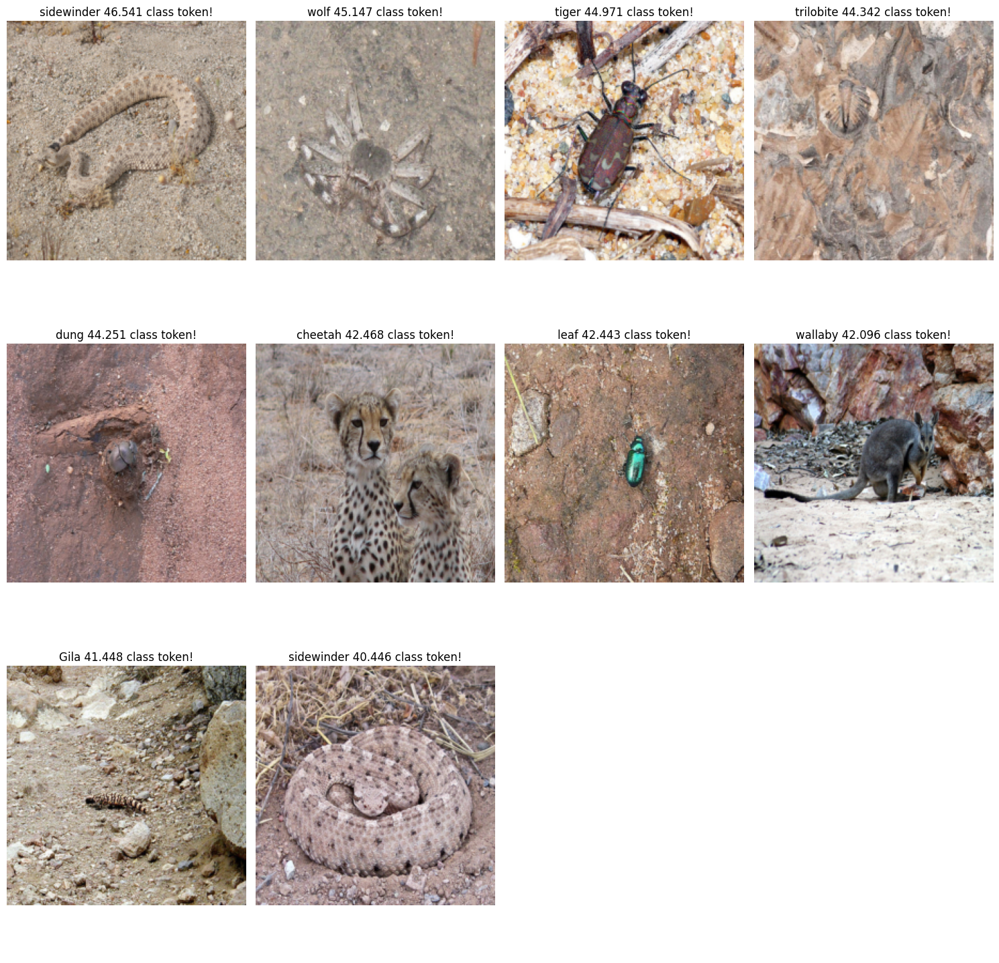

In [37]:
for feature_ids in top_per_feature.keys():
    print(f"looking at {feature_ids}")
    max_vals, max_inds = top_per_feature[feature_ids]
    images = []
    gt_labels = []
    print(max_vals)
    for id, v in zip(max_inds, max_vals):
        bid, pid = id 

        image, label, image_ind = imagenet_data[bid]

        print(image_ind.item(), bid)
        assert image_ind.item() == bid
        images.append(image)
        gt_labels.append(ind_to_name[label])
    
    grid_size = int(np.ceil(np.sqrt(len(images))))
    fig, axs = plt.subplots(int(np.ceil(len(images)/grid_size)), grid_size, figsize=(15, 15))
    for ax in axs.flatten():
        ax.axis('off')
    for i, (image_tensor, label, val, id) in enumerate(zip(images, gt_labels, max_vals,max_inds )):




        row = i // grid_size
        col = i % grid_size
        
        display = image_tensor.numpy().transpose(1, 2, 0)

        bid, pid = id 
        if pid == 0:
            pass
        else:
            pid_r = (pid-1)//14
            pid_c = (pid-1)%14
            
            display[pid_r*16:(pid_r+1)*16, pid_c*16:(pid_c+1)*16,:] = display[pid_r*16:(pid_r+1)*16, pid_c*16:(pid_c+1)*16,:]*0.75 + 0.25*np.zeros_like(display[pid_r*16:(pid_r+1)*16, pid_c*16:(pid_c+1)*16,:])
            display[pid_r*16:(pid_r+1)*16, pid_c*16,0] = 1.0
            display[pid_r*16:(pid_r+1)*16, (pid_c+1)*16-1,0] = 1.0
            display[pid_r*16, pid_c*16:(pid_c+1)*16,0] =1.0
            display[(pid_r+1)*16-1, pid_c*16:(pid_c+1)*16,0]  =1.0


        axs[row, col].imshow(display)
        axs[row, col].set_title(f"{label} {val.item():0.03f} {'class token!' if pid==0 else ''}")  
        axs[row, col].axis('off')  

    plt.tight_layout()
    plt.show()
